In [1]:
import glob
import os
import yaml
import argparse
import torch
import torchvision
import torch.nn as nn
from PIL import Image
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
from torch.utils.data.dataloader import DataLoader
from torch.utils.data.dataset import Dataset
from torchvision.utils import make_grid
import torchvision.transforms as transforms
from torchvision.datasets import MNIST
from torch.optim import Adam
from torch.utils.data import DataLoader

In [2]:
config={'diffusion_params':{
  'num_timesteps' : 1000,
  'beta_start' : 0.0001,
  'beta_end' : 0.02},

'model_params':
  {'im_channels' : 1,
  'im_size' : 28,
  'down_channels' : [32, 64, 128, 256],
  'mid_channels' : [256, 256, 128],
  'down_sample' : [True, True, False],
  'time_emb_dim' : 128,
  'num_down_layers' : 2,
  'num_mid_layers' : 2,
  'num_up_layers': 2,
  'num_heads' : 4},

'train_params':
  {'task_name': 'default',
  'batch_size': 64,
  'num_epochs': 25,
  'num_samples' : 100,
  'num_grid_rows' : 10,
  'lr': 0.0001,
  'ckpt_name': 'ddpm_ckpt.pth'}}

In [3]:
class MnistDataset(Dataset):
    """
    Dataset class for MNIST images using torchvision's MNIST dataset.
    """

    def __init__(self, split='train'):
        """
        Init method for initializing the dataset properties.
        :param split: 'train' or 'test' to specify the dataset split
        """
        self.split = split
        self.transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.5,), (0.5,))  # Normalize to [-1, 1]
        ])

        # Use PyTorch's built-in MNIST dataset
        self.dataset = MNIST(
            root='data',
            train=(split == 'train'),
            transform=self.transform,
            download=True
        )

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, index):
        # Get image and label
        im, label = self.dataset[index]
        return im

In [4]:
def get_time_embedding(time_steps, temb_dim):
    r"""
    Convert time steps tensor into an embedding using the
    sinusoidal time embedding formula
    :param time_steps: 1D tensor of length batch size
    :param temb_dim: Dimension of the embedding
    :return: BxD embedding representation of B time steps
    """
    assert temb_dim % 2 == 0, "time embedding dimension must be divisible by 2"

    # factor = 10000^(2i/d_model)
    factor = 10000 ** ((torch.arange(
        start=0, end=temb_dim // 2, dtype=torch.float32, device=time_steps.device) / (temb_dim // 2))
    )

    # pos / factor
    # timesteps B -> B, 1 -> B, temb_dim
    t_emb = time_steps[:, None].repeat(1, temb_dim // 2) / factor
    t_emb = torch.cat([torch.sin(t_emb), torch.cos(t_emb)], dim=-1)
    return t_emb

In [5]:
class DownBlock(nn.Module):
    r"""
    Down conv block with attention.
    Sequence of following block
    1. Resnet block with time embedding
    2. Attention block
    3. Downsample using 2x2 average pooling
    """
    def __init__(self, in_channels, out_channels, t_emb_dim,
                 down_sample=True, num_heads=4, num_layers=1):
        super().__init__()
        self.num_layers = num_layers
        self.down_sample = down_sample
        self.resnet_conv_first = nn.ModuleList(
            [
                nn.Sequential(
                    nn.GroupNorm(8, in_channels if i == 0 else out_channels),
                    nn.SiLU(),
                    nn.Conv2d(in_channels if i == 0 else out_channels, out_channels,
                              kernel_size=3, stride=1, padding=1),
                )
                for i in range(num_layers)
            ]
        )
        self.t_emb_layers = nn.ModuleList([
            nn.Sequential(
                nn.SiLU(),
                nn.Linear(t_emb_dim, out_channels)
            )
            for _ in range(num_layers)
        ])
        self.resnet_conv_second = nn.ModuleList(
            [
                nn.Sequential(
                    nn.GroupNorm(8, out_channels),
                    nn.SiLU(),
                    nn.Conv2d(out_channels, out_channels,
                              kernel_size=3, stride=1, padding=1),
                )
                for _ in range(num_layers)
            ]
        )
        self.attention_norms = nn.ModuleList(
            [nn.GroupNorm(8, out_channels)
             for _ in range(num_layers)]
        )

        self.attentions = nn.ModuleList(
            [nn.MultiheadAttention(out_channels, num_heads, batch_first=True)
             for _ in range(num_layers)]
        )
        self.residual_input_conv = nn.ModuleList(
            [
                nn.Conv2d(in_channels if i == 0 else out_channels, out_channels, kernel_size=1)
                for i in range(num_layers)
            ]
        )
        self.down_sample_conv = nn.Conv2d(out_channels, out_channels,
                                          4, 2, 1) if self.down_sample else nn.Identity()

    def forward(self, x, t_emb):
        out = x
        for i in range(self.num_layers):

            # Resnet block of Unet
            resnet_input = out
            out = self.resnet_conv_first[i](out)
            out = out + self.t_emb_layers[i](t_emb)[:, :, None, None]
            out = self.resnet_conv_second[i](out)
            out = out + self.residual_input_conv[i](resnet_input)

            # Attention block of Unet
            batch_size, channels, h, w = out.shape
            in_attn = out.reshape(batch_size, channels, h * w)
            in_attn = self.attention_norms[i](in_attn)
            in_attn = in_attn.transpose(1, 2)
            out_attn, _ = self.attentions[i](in_attn, in_attn, in_attn)
            out_attn = out_attn.transpose(1, 2).reshape(batch_size, channels, h, w)
            out = out + out_attn

        out = self.down_sample_conv(out)
        return out

In [6]:
class MidBlock(nn.Module):
    r"""
    Mid conv block with attention.
    Sequence of following blocks
    1. Resnet block with time embedding
    2. Attention block
    3. Resnet block with time embedding
    """
    def __init__(self, in_channels, out_channels, t_emb_dim, num_heads=4, num_layers=1):
        super().__init__()
        self.num_layers = num_layers
        self.resnet_conv_first = nn.ModuleList(
            [
                nn.Sequential(
                    nn.GroupNorm(8, in_channels if i == 0 else out_channels),
                    nn.SiLU(),
                    nn.Conv2d(in_channels if i == 0 else out_channels, out_channels, kernel_size=3, stride=1,
                              padding=1),
                )
                for i in range(num_layers+1)
            ]
        )
        self.t_emb_layers = nn.ModuleList([
            nn.Sequential(
                nn.SiLU(),
                nn.Linear(t_emb_dim, out_channels)
            )
            for _ in range(num_layers + 1)
        ])
        self.resnet_conv_second = nn.ModuleList(
            [
                nn.Sequential(
                    nn.GroupNorm(8, out_channels),
                    nn.SiLU(),
                    nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1),
                )
                for _ in range(num_layers+1)
            ]
        )

        self.attention_norms = nn.ModuleList(
            [nn.GroupNorm(8, out_channels)
                for _ in range(num_layers)]
        )

        self.attentions = nn.ModuleList(
            [nn.MultiheadAttention(out_channels, num_heads, batch_first=True)
                for _ in range(num_layers)]
        )
        self.residual_input_conv = nn.ModuleList(
            [
                nn.Conv2d(in_channels if i == 0 else out_channels, out_channels, kernel_size=1)
                for i in range(num_layers+1)
            ]
        )

    def forward(self, x, t_emb):
        out = x

        # First resnet block
        resnet_input = out
        out = self.resnet_conv_first[0](out)
        out = out + self.t_emb_layers[0](t_emb)[:, :, None, None]
        out = self.resnet_conv_second[0](out)
        out = out + self.residual_input_conv[0](resnet_input)

        for i in range(self.num_layers):

            # Attention Block
            batch_size, channels, h, w = out.shape
            in_attn = out.reshape(batch_size, channels, h * w)
            in_attn = self.attention_norms[i](in_attn)
            in_attn = in_attn.transpose(1, 2)
            out_attn, _ = self.attentions[i](in_attn, in_attn, in_attn)
            out_attn = out_attn.transpose(1, 2).reshape(batch_size, channels, h, w)
            out = out + out_attn

            # Resnet Block
            resnet_input = out
            out = self.resnet_conv_first[i+1](out)
            out = out + self.t_emb_layers[i+1](t_emb)[:, :, None, None]
            out = self.resnet_conv_second[i+1](out)
            out = out + self.residual_input_conv[i+1](resnet_input)

        return out

In [7]:
class UpBlock(nn.Module):
    r"""
    Up conv block with attention.
    Sequence of following blocks
    1. Upsample
    1. Concatenate Down block output
    2. Resnet block with time embedding
    3. Attention Block
    """
    def __init__(self, in_channels, out_channels, t_emb_dim, up_sample=True, num_heads=4, num_layers=1):
        super().__init__()
        self.num_layers = num_layers
        self.up_sample = up_sample
        self.resnet_conv_first = nn.ModuleList(
            [
                nn.Sequential(
                    nn.GroupNorm(8, in_channels if i == 0 else out_channels),
                    nn.SiLU(),
                    nn.Conv2d(in_channels if i == 0 else out_channels, out_channels, kernel_size=3, stride=1,
                              padding=1),
                )
                for i in range(num_layers)
            ]
        )
        self.t_emb_layers = nn.ModuleList([
            nn.Sequential(
                nn.SiLU(),
                nn.Linear(t_emb_dim, out_channels)
            )
            for _ in range(num_layers)
        ])
        self.resnet_conv_second = nn.ModuleList(
            [
                nn.Sequential(
                    nn.GroupNorm(8, out_channels),
                    nn.SiLU(),
                    nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1),
                )
                for _ in range(num_layers)
            ]
        )

        self.attention_norms = nn.ModuleList(
            [
                nn.GroupNorm(8, out_channels)
                for _ in range(num_layers)
            ]
        )

        self.attentions = nn.ModuleList(
            [
                nn.MultiheadAttention(out_channels, num_heads, batch_first=True)
                for _ in range(num_layers)
            ]
        )
        self.residual_input_conv = nn.ModuleList(
            [
                nn.Conv2d(in_channels if i == 0 else out_channels, out_channels, kernel_size=1)
                for i in range(num_layers)
            ]
        )
        self.up_sample_conv = nn.ConvTranspose2d(in_channels // 2, in_channels // 2,
                                                 4, 2, 1) \
            if self.up_sample else nn.Identity()

    def forward(self, x, out_down, t_emb):
        x = self.up_sample_conv(x)
        x = torch.cat([x, out_down], dim=1)

        out = x
        for i in range(self.num_layers):
            resnet_input = out
            out = self.resnet_conv_first[i](out)
            out = out + self.t_emb_layers[i](t_emb)[:, :, None, None]
            out = self.resnet_conv_second[i](out)
            out = out + self.residual_input_conv[i](resnet_input)

            batch_size, channels, h, w = out.shape
            in_attn = out.reshape(batch_size, channels, h * w)
            in_attn = self.attention_norms[i](in_attn)
            in_attn = in_attn.transpose(1, 2)
            out_attn, _ = self.attentions[i](in_attn, in_attn, in_attn)
            out_attn = out_attn.transpose(1, 2).reshape(batch_size, channels, h, w)
            out = out + out_attn

        return out

In [8]:
class Unet(nn.Module):
    r"""
    Unet model comprising
    Down blocks, Midblocks and Uplocks
    """
    def __init__(self, model_config):
        super().__init__()
        im_channels = model_config['im_channels']
        self.down_channels = model_config['down_channels']
        self.mid_channels = model_config['mid_channels']
        self.t_emb_dim = model_config['time_emb_dim']
        self.down_sample = model_config['down_sample']
        self.num_down_layers = model_config['num_down_layers']
        self.num_mid_layers = model_config['num_mid_layers']
        self.num_up_layers = model_config['num_up_layers']

        assert self.mid_channels[0] == self.down_channels[-1]
        assert self.mid_channels[-1] == self.down_channels[-2]
        assert len(self.down_sample) == len(self.down_channels) - 1

        # Initial projection from sinusoidal time embedding
        self.t_proj = nn.Sequential(
            nn.Linear(self.t_emb_dim, self.t_emb_dim),
            nn.SiLU(),
            nn.Linear(self.t_emb_dim, self.t_emb_dim)
        )

        self.up_sample = list(reversed(self.down_sample))
        self.conv_in = nn.Conv2d(im_channels, self.down_channels[0], kernel_size=3, padding=(1, 1))

        self.downs = nn.ModuleList([])
        for i in range(len(self.down_channels)-1):
            self.downs.append(DownBlock(self.down_channels[i], self.down_channels[i+1], self.t_emb_dim,
                                        down_sample=self.down_sample[i], num_layers=self.num_down_layers))

        self.mids = nn.ModuleList([])
        for i in range(len(self.mid_channels)-1):
            self.mids.append(MidBlock(self.mid_channels[i], self.mid_channels[i+1], self.t_emb_dim,
                                      num_layers=self.num_mid_layers))

        self.ups = nn.ModuleList([])
        for i in reversed(range(len(self.down_channels)-1)):
            self.ups.append(UpBlock(self.down_channels[i] * 2, self.down_channels[i-1] if i != 0 else 16,
                                    self.t_emb_dim, up_sample=self.down_sample[i], num_layers=self.num_up_layers))

        self.norm_out = nn.GroupNorm(8, 16)
        self.conv_out = nn.Conv2d(16, im_channels, kernel_size=3, padding=1)

    def forward(self, x, t):
        # Shapes assuming downblocks are [C1, C2, C3, C4]
        # Shapes assuming midblocks are [C4, C4, C3]
        # Shapes assuming downsamples are [True, True, False]
        # B x C x H x W
        out = self.conv_in(x)
        # B x C1 x H x W

        # t_emb -> B x t_emb_dim
        t_emb = get_time_embedding(torch.as_tensor(t).long(), self.t_emb_dim)
        t_emb = self.t_proj(t_emb)

        down_outs = []

        for idx, down in enumerate(self.downs):
            down_outs.append(out)
            out = down(out, t_emb)
        # down_outs  [B x C1 x H x W, B x C2 x H/2 x W/2, B x C3 x H/4 x W/4]
        # out B x C4 x H/4 x W/4

        for mid in self.mids:
            out = mid(out, t_emb)
        # out B x C3 x H/4 x W/4

        for up in self.ups:
            down_out = down_outs.pop()
            out = up(out, down_out, t_emb)
            # out [B x C2 x H/4 x W/4, B x C1 x H/2 x W/2, B x 16 x H x W]
        out = self.norm_out(out)
        out = nn.SiLU()(out)
        out = self.conv_out(out)
        # out B x C x H x W
        return out

In [9]:
class LinearNoiseScheduler:
    r"""
    Class for the linear noise scheduler that is used in DDPM.
    """
    def __init__(self, num_timesteps, beta_start, beta_end):
        self.num_timesteps = num_timesteps
        self.beta_start = beta_start
        self.beta_end = beta_end

        self.betas = torch.linspace(beta_start, beta_end, num_timesteps)
        self.alphas = 1. - self.betas
        self.alpha_cum_prod = torch.cumprod(self.alphas, dim=0)
        self.sqrt_alpha_cum_prod = torch.sqrt(self.alpha_cum_prod)
        self.sqrt_one_minus_alpha_cum_prod = torch.sqrt(1 - self.alpha_cum_prod)

    def add_noise(self, original, noise, t):
        r"""
        Forward method for diffusion
        :param original: Image on which noise is to be applied
        :param noise: Random Noise Tensor (from normal dist)
        :param t: timestep of the forward process of shape -> (B,)
        :return:
        """
        original_shape = original.shape
        batch_size = original_shape[0]

        sqrt_alpha_cum_prod = self.sqrt_alpha_cum_prod.to(original.device)[t].reshape(batch_size)
        sqrt_one_minus_alpha_cum_prod = self.sqrt_one_minus_alpha_cum_prod.to(original.device)[t].reshape(batch_size)

        # Reshape till (B,) becomes (B,1,1,1) if image is (B,C,H,W)
        for _ in range(len(original_shape) - 1):
            sqrt_alpha_cum_prod = sqrt_alpha_cum_prod.unsqueeze(-1)
        for _ in range(len(original_shape) - 1):
            sqrt_one_minus_alpha_cum_prod = sqrt_one_minus_alpha_cum_prod.unsqueeze(-1)

        # Apply and Return Forward process equation
        return (sqrt_alpha_cum_prod.to(original.device) * original
                + sqrt_one_minus_alpha_cum_prod.to(original.device) * noise)

    def sample_prev_timestep(self, xt, noise_pred, t):
        r"""
            Use the noise prediction by model to get
            xt-1 using xt and the noise predicted
        :param xt: current timestep sample
        :param noise_pred: model noise prediction
        :param t: current timestep we are at
        :return:
        """
        x0 = ((xt - (self.sqrt_one_minus_alpha_cum_prod.to(xt.device)[t] * noise_pred)) /
              torch.sqrt(self.alpha_cum_prod.to(xt.device)[t]))
        x0 = torch.clamp(x0, -1., 1.)

        mean = xt - ((self.betas.to(xt.device)[t]) * noise_pred) / (self.sqrt_one_minus_alpha_cum_prod.to(xt.device)[t])
        mean = mean / torch.sqrt(self.alphas.to(xt.device)[t])

        if t == 0:
            return mean, x0
        else:
            variance = (1 - self.alpha_cum_prod.to(xt.device)[t - 1]) / (1.0 - self.alpha_cum_prod.to(xt.device)[t])
            variance = variance * self.betas.to(xt.device)[t]
            sigma = variance ** 0.5
            z = torch.randn(xt.shape).to(xt.device)
            return mean + sigma * z, x0

In [10]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def train(config):

    diffusion_config = config['diffusion_params']
    model_config = config['model_params']
    train_config = config['train_params']

    # Create the noise scheduler
    scheduler = LinearNoiseScheduler(num_timesteps=diffusion_config['num_timesteps'],
                                     beta_start=diffusion_config['beta_start'],
                                     beta_end=diffusion_config['beta_end'])

    # Create the dataset
    mnist = MnistDataset(split='train')
    mnist_loader = DataLoader(mnist, batch_size=config['train_params']['batch_size'], shuffle=True, num_workers=0)


    # Instantiate the model
    model = Unet(model_config).to(device)
    model.train()

    # Create output directories
    if not os.path.exists(train_config['task_name']):
        os.mkdir(train_config['task_name'])

    # Load checkpoint if found
    if os.path.exists(os.path.join(train_config['task_name'],train_config['ckpt_name'])):
        print('Loading checkpoint as found one')
        model.load_state_dict(torch.load(os.path.join(train_config['task_name'],
                                                      train_config['ckpt_name']), map_location=device))
    # Specify training parameters
    num_epochs = train_config['num_epochs']
    optimizer = Adam(model.parameters(), lr=train_config['lr'])
    criterion = torch.nn.MSELoss()

    # Run training
    for epoch_idx in range(num_epochs):
        losses = []
        for im in tqdm(mnist_loader):
            optimizer.zero_grad()
            im = im.float().to(device)

            # Sample random noise
            noise = torch.randn_like(im).to(device)

            # Sample timestep
            t = torch.randint(0, diffusion_config['num_timesteps'], (im.shape[0],)).to(device)

            # Add noise to images according to timestep
            noisy_im = scheduler.add_noise(im, noise, t)
            noise_pred = model(noisy_im, t)

            loss = criterion(noise_pred, noise)
            losses.append(loss.item())
            loss.backward()
            optimizer.step()
        print('Finished epoch:{} | Loss : {:.4f}'.format(
            epoch_idx + 1,
            np.mean(losses),
        ))
        torch.save(model.state_dict(), os.path.join(train_config['task_name'],
                                                    train_config['ckpt_name']))

    print('Done Training ...')

In [11]:
train(config)

Failed to download (trying next):
<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: certificate has expired (_ssl.c:1007)>



100%|██████████| 9.91M/9.91M [00:00<00:00, 16.3MB/s]


Extracting data/MNIST/raw/train-images-idx3-ubyte.gz to data/MNIST/raw

Failed to download (trying next):
<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: certificate has expired (_ssl.c:1007)>



100%|██████████| 28.9k/28.9k [00:00<00:00, 499kB/s]


Extracting data/MNIST/raw/train-labels-idx1-ubyte.gz to data/MNIST/raw

Failed to download (trying next):
<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: certificate has expired (_ssl.c:1007)>



100%|██████████| 1.65M/1.65M [00:00<00:00, 4.55MB/s]


Extracting data/MNIST/raw/t10k-images-idx3-ubyte.gz to data/MNIST/raw

Failed to download (trying next):
<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: certificate has expired (_ssl.c:1007)>



100%|██████████| 4.54k/4.54k [00:00<00:00, 7.68MB/s]


Extracting data/MNIST/raw/t10k-labels-idx1-ubyte.gz to data/MNIST/raw



100%|██████████| 938/938 [05:16<00:00,  2.96it/s]


Finished epoch:1 | Loss : 0.1023


100%|██████████| 938/938 [05:16<00:00,  2.97it/s]


Finished epoch:2 | Loss : 0.0352


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:3 | Loss : 0.0302


100%|██████████| 938/938 [05:16<00:00,  2.97it/s]


Finished epoch:4 | Loss : 0.0280


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:5 | Loss : 0.0266


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:6 | Loss : 0.0262


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:7 | Loss : 0.0253


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:8 | Loss : 0.0251


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:9 | Loss : 0.0248


100%|██████████| 938/938 [05:16<00:00,  2.96it/s]


Finished epoch:10 | Loss : 0.0247


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:11 | Loss : 0.0241


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:12 | Loss : 0.0238


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:13 | Loss : 0.0237


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:14 | Loss : 0.0238


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:15 | Loss : 0.0236


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:16 | Loss : 0.0238


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:17 | Loss : 0.0232


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:18 | Loss : 0.0230


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:19 | Loss : 0.0229


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:20 | Loss : 0.0228


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:21 | Loss : 0.0227


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:22 | Loss : 0.0227


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:23 | Loss : 0.0224


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]


Finished epoch:24 | Loss : 0.0224


100%|██████████| 938/938 [05:15<00:00,  2.97it/s]

Finished epoch:25 | Loss : 0.0225
Done Training ...


In [15]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def sample(model, scheduler, train_config, model_config, diffusion_config):
    """
    Sample stepwise by going backward one timestep at a time and display images in the notebook
    every 10 steps.
    """
    xt = torch.randn((train_config['num_samples'],
                      model_config['im_channels'],
                      model_config['im_size'],
                      model_config['im_size'])).to(device)

    plt.figure(figsize=(10, 10))  # Adjust size as necessary
    for i in tqdm(reversed(range(diffusion_config['num_timesteps']))):
        # Get prediction of noise
        noise_pred = model(xt, torch.as_tensor(i).unsqueeze(0).to(device))

        # Use scheduler to get x0 and xt-1
        xt, x0_pred = scheduler.sample_prev_timestep(xt, noise_pred, torch.as_tensor(i).to(device))

        # Display every 10th timestep
        if i % 10 == 0:
            ims = torch.clamp(xt, -1., 1.).detach().cpu()
            ims = (ims + 1) / 2  # Normalize to [0, 1] for display
            grid = make_grid(ims, nrow=train_config['num_grid_rows'])

            # Convert to numpy array for display with matplotlib
            np_img = grid.permute(1, 2, 0).numpy()

            # Clear previous plot and display the new image
            plt.imshow(np_img)
            plt.title(f"Timestep {i}")
            plt.axis('off')
            plt.show()

In [16]:
def infer(config):
    diffusion_config = config['diffusion_params']
    model_config = config['model_params']
    train_config = config['train_params']

    # Load model with checkpoint
    model = Unet(model_config).to(device)
    model.load_state_dict(torch.load(os.path.join(train_config['task_name'],
                                                  train_config['ckpt_name']), map_location=device))
    model.eval()

    # Create the noise scheduler
    scheduler = LinearNoiseScheduler(num_timesteps=diffusion_config['num_timesteps'],
                                     beta_start=diffusion_config['beta_start'],
                                     beta_end=diffusion_config['beta_end'])
    with torch.no_grad():
        sample(model, scheduler, train_config, model_config, diffusion_config)

<ipython-input-16-9c1f30fa3e3c>:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(os.path.join(train_config['task_name'],
9it [00:01,  5.29it

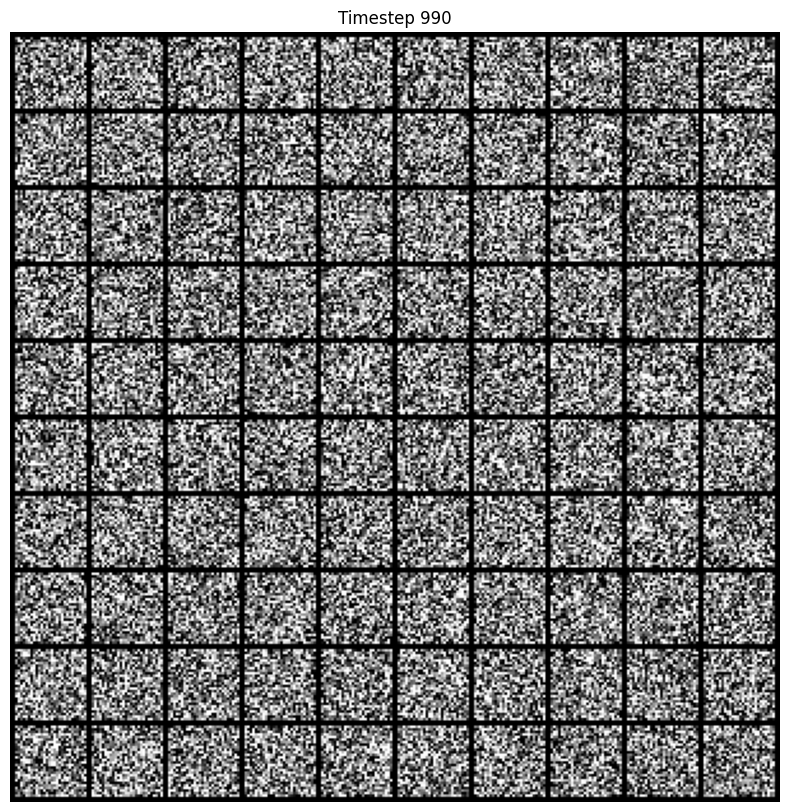

19it [00:04,  5.05it/s]

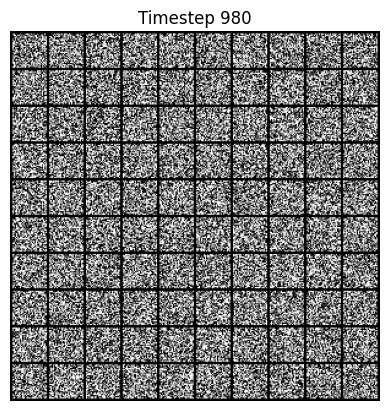

29it [00:06,  5.01it/s]

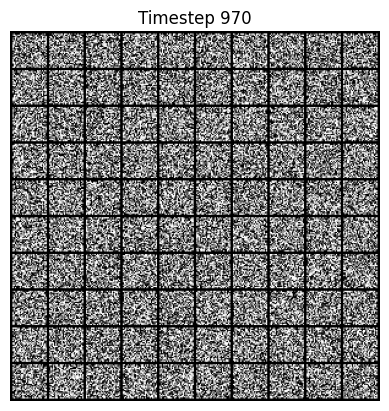

39it [00:08,  5.12it/s]

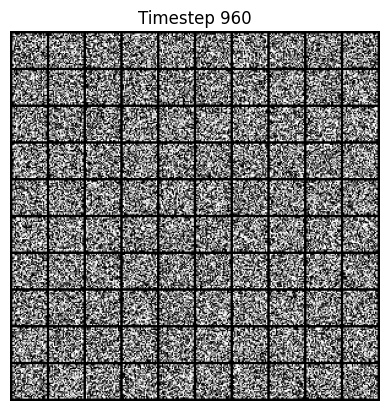

49it [00:10,  5.25it/s]

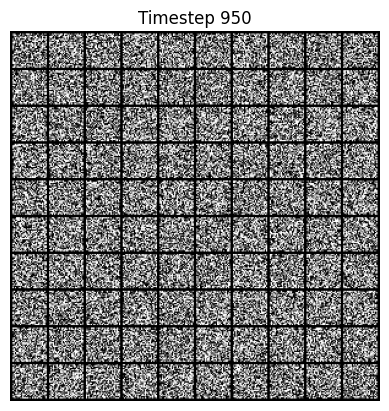

59it [00:12,  5.25it/s]

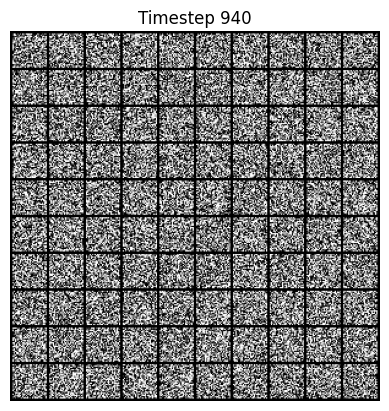

69it [00:14,  5.20it/s]

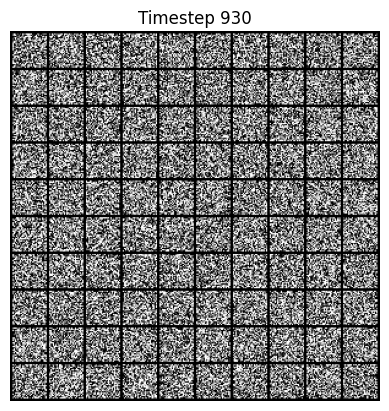

79it [00:16,  5.14it/s]

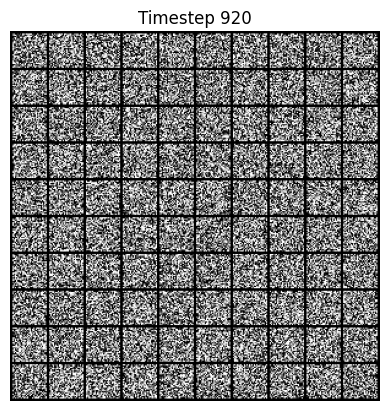

89it [00:18,  5.20it/s]

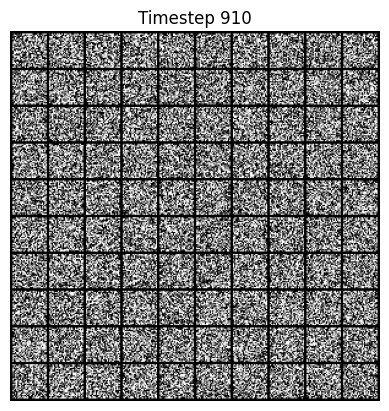

99it [00:21,  5.19it/s]

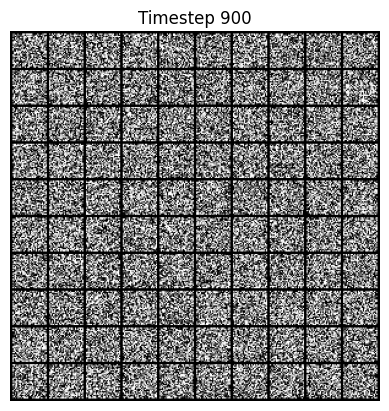

109it [00:23,  5.19it/s]

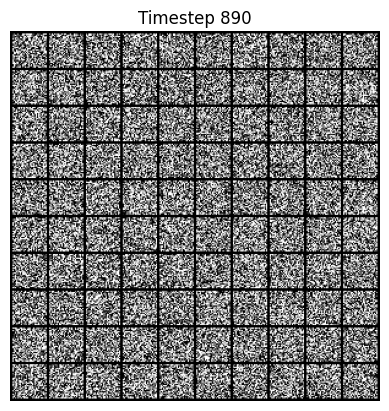

119it [00:25,  5.20it/s]

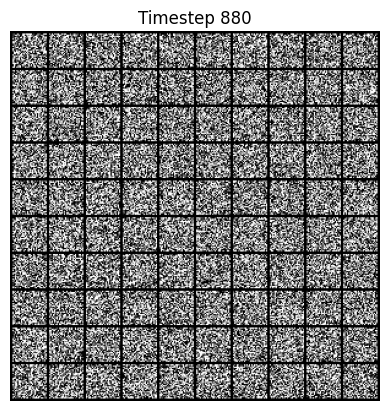

129it [00:27,  5.20it/s]

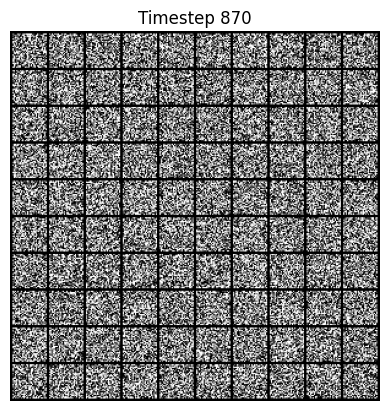

139it [00:29,  5.13it/s]

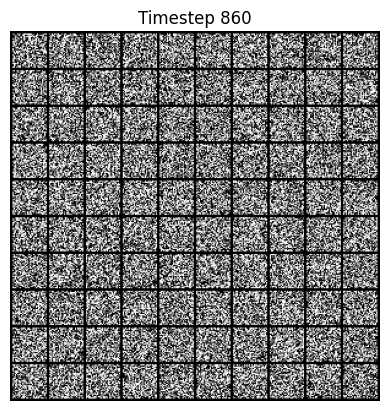

149it [00:31,  5.15it/s]

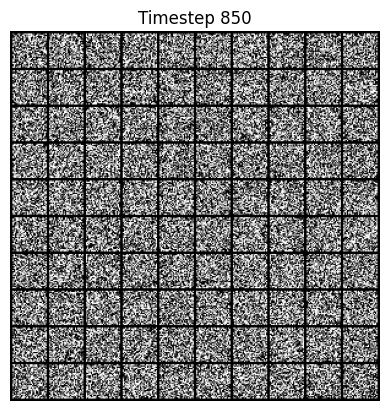

159it [00:33,  5.21it/s]

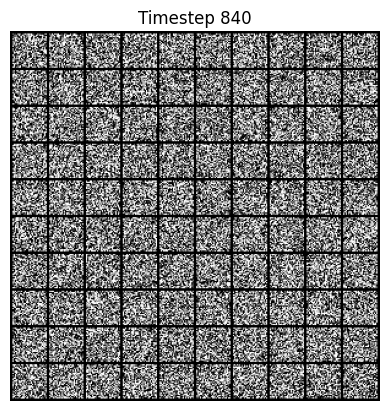

169it [00:35,  5.23it/s]

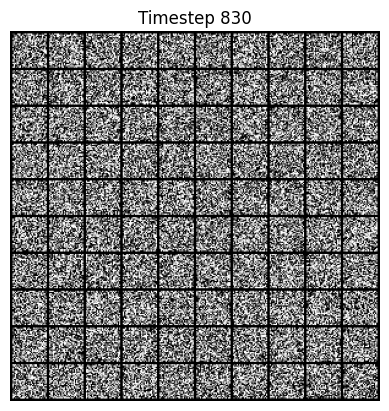

179it [00:37,  5.21it/s]

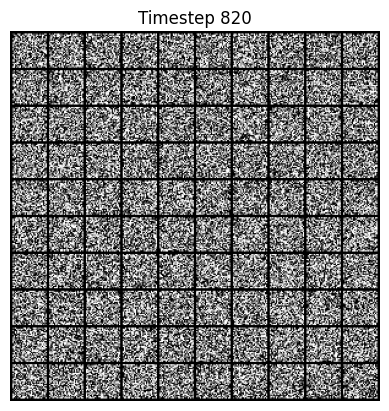

189it [00:39,  5.24it/s]

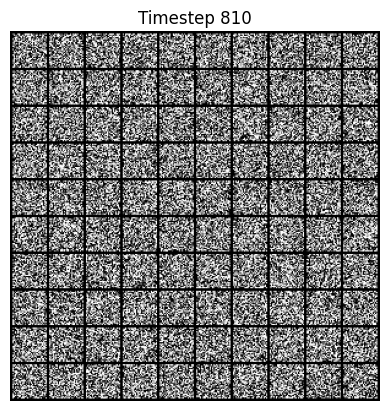

199it [00:42,  5.22it/s]

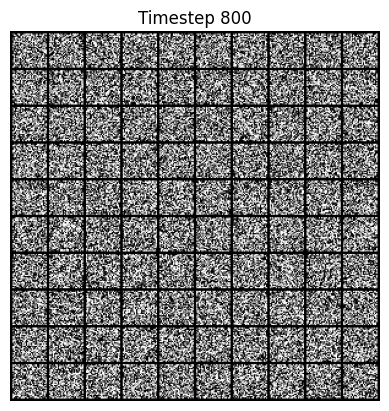

209it [00:44,  5.13it/s]

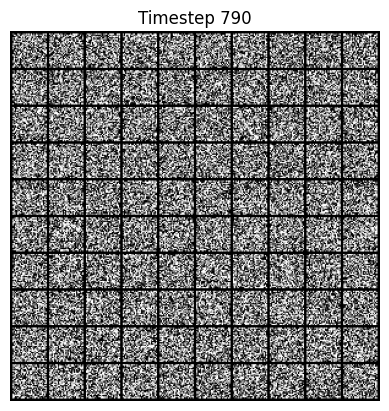

219it [00:46,  5.17it/s]

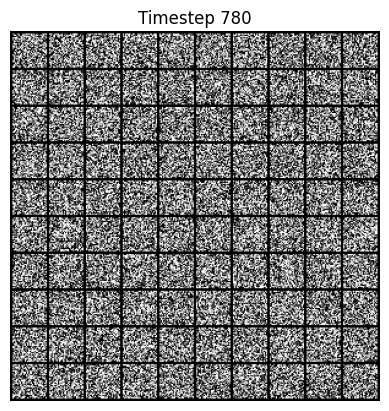

229it [00:48,  5.24it/s]

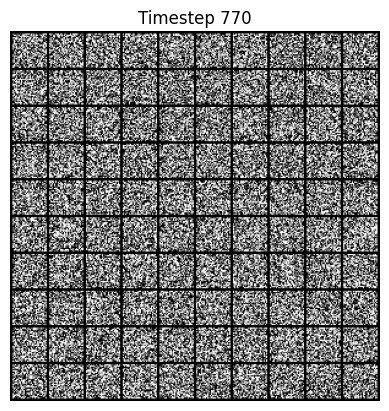

239it [00:50,  5.25it/s]

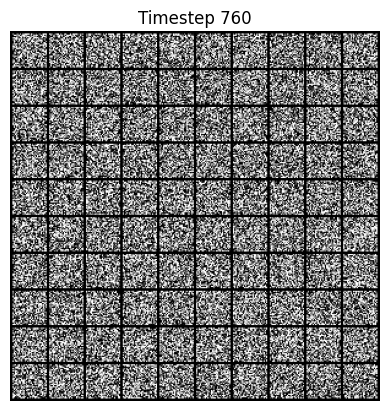

249it [00:52,  5.24it/s]

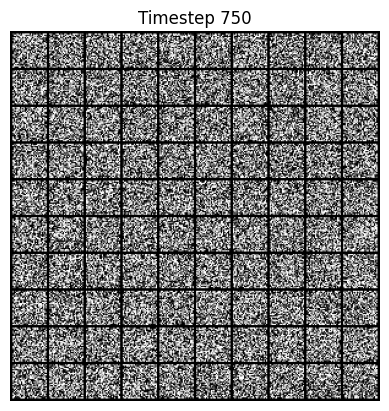

259it [00:54,  5.25it/s]

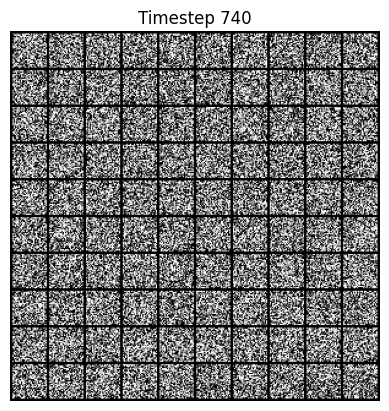

269it [00:56,  5.19it/s]

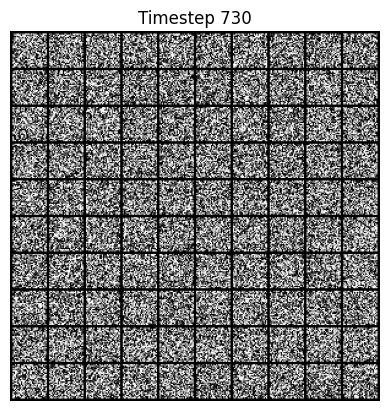

279it [00:58,  5.18it/s]

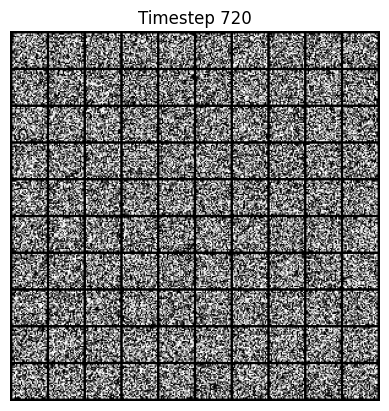

289it [01:01,  5.21it/s]

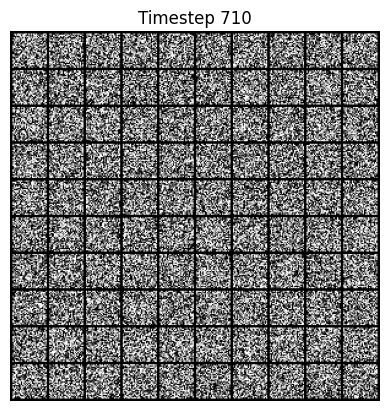

299it [01:03,  5.22it/s]

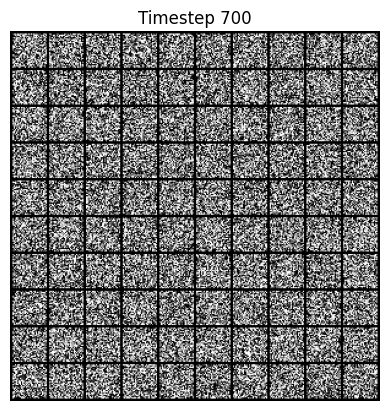

309it [01:05,  5.23it/s]

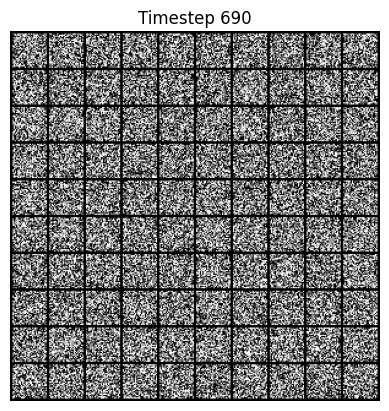

319it [01:07,  5.22it/s]

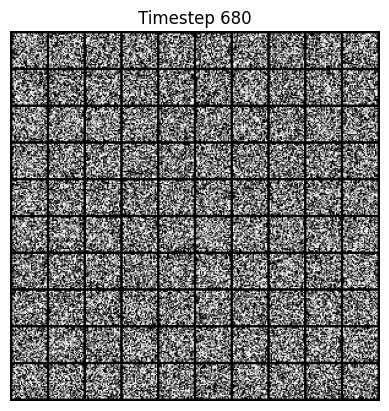

329it [01:09,  5.22it/s]

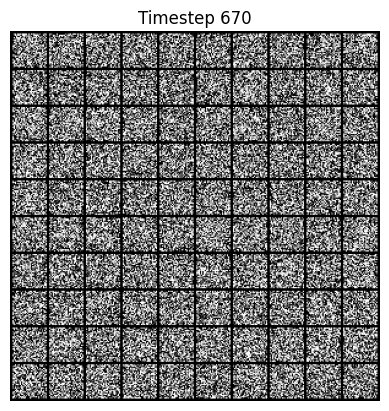

339it [01:11,  5.11it/s]

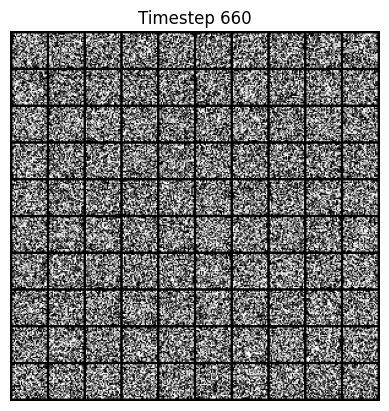

349it [01:14,  5.14it/s]

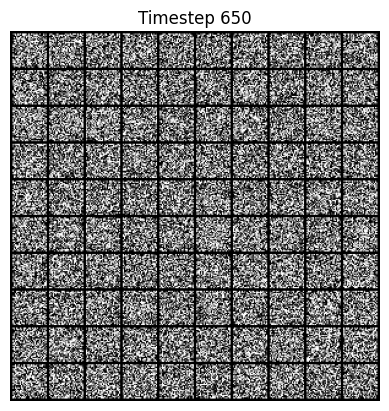

359it [01:16,  5.19it/s]

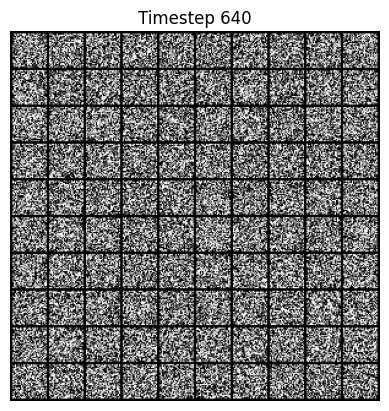

369it [01:18,  5.18it/s]

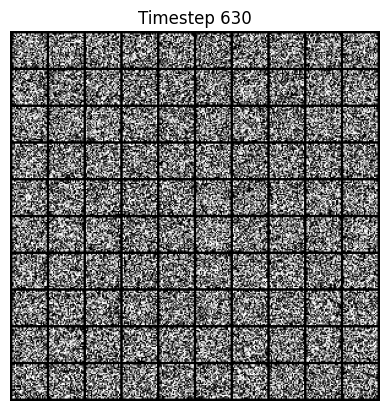

379it [01:20,  5.22it/s]

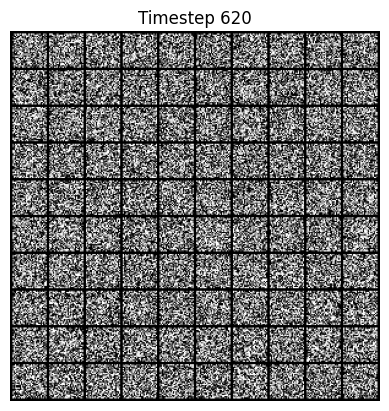

389it [01:22,  5.20it/s]

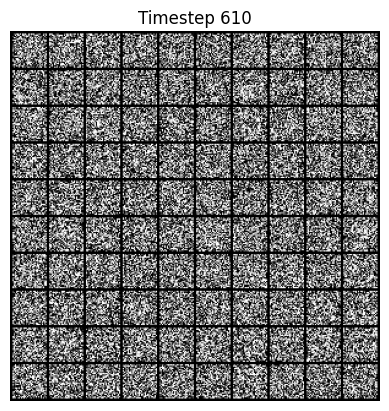

399it [01:24,  5.17it/s]

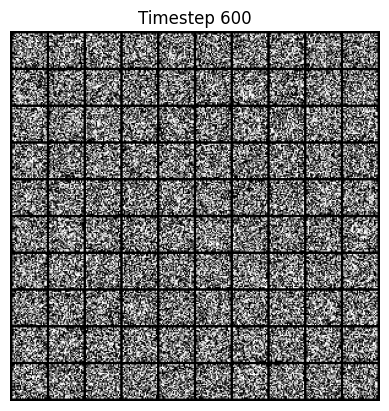

409it [01:27,  5.15it/s]

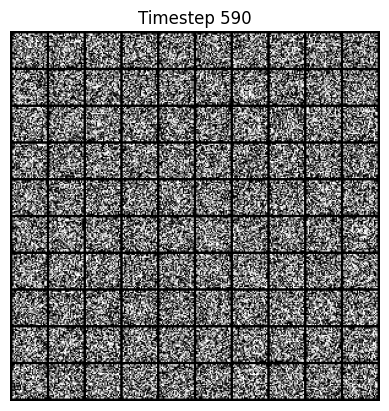

419it [01:29,  5.10it/s]

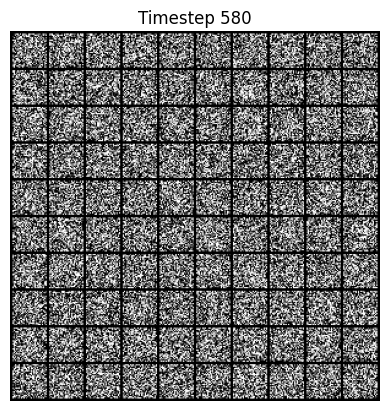

429it [01:31,  5.22it/s]

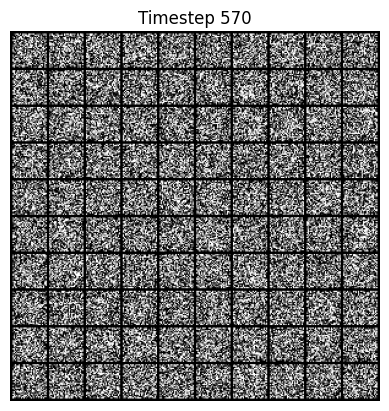

439it [01:33,  5.21it/s]

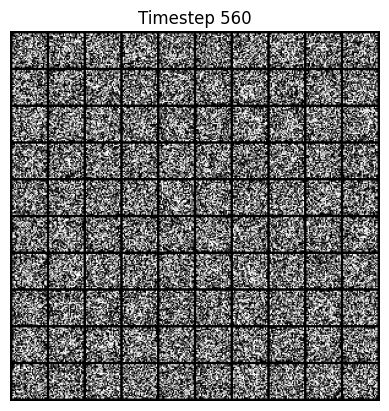

449it [01:35,  5.19it/s]

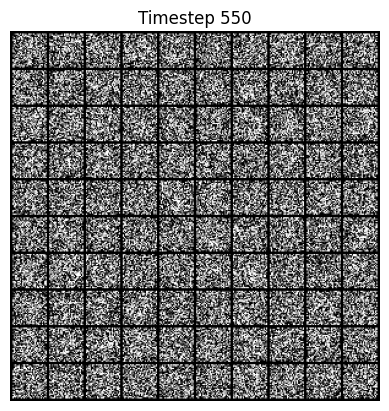

459it [01:38,  5.18it/s]

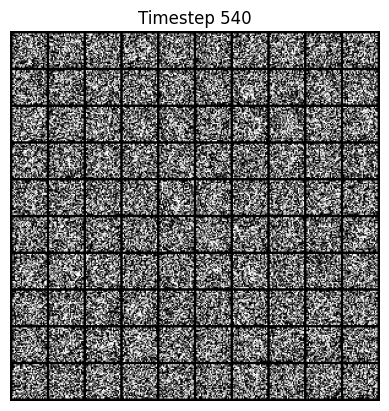

469it [01:40,  5.17it/s]

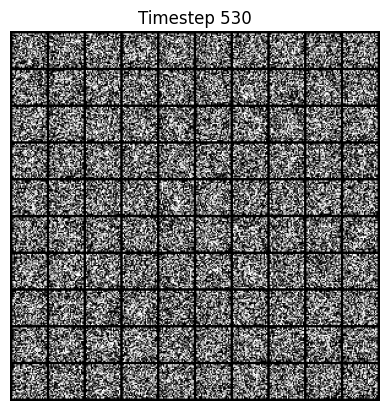

479it [01:42,  5.16it/s]

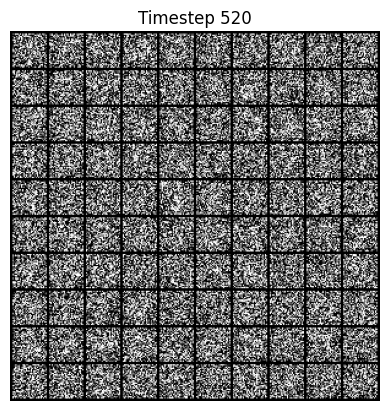

489it [01:44,  5.18it/s]

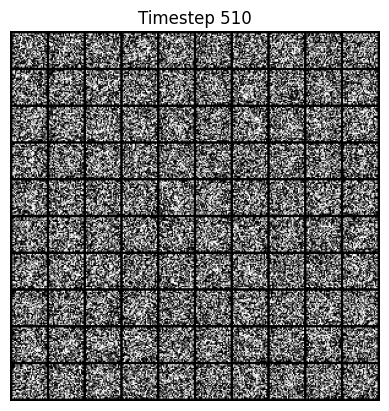

499it [01:46,  5.15it/s]

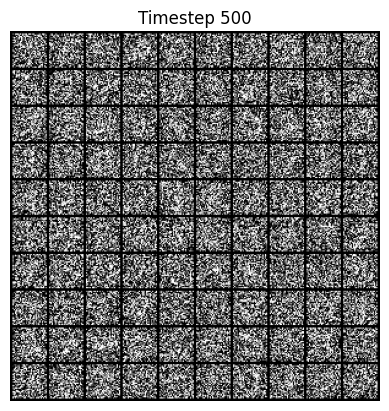

509it [01:48,  5.18it/s]

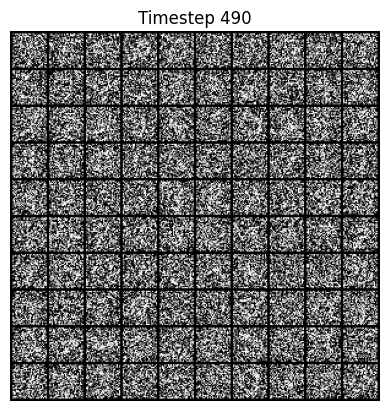

519it [01:51,  5.18it/s]

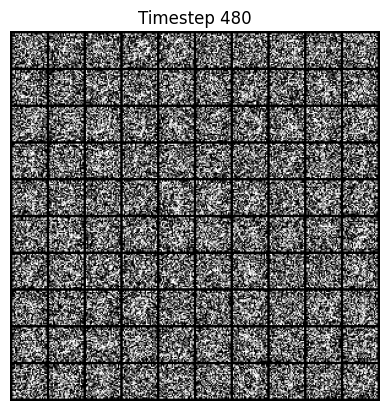

529it [01:53,  5.18it/s]

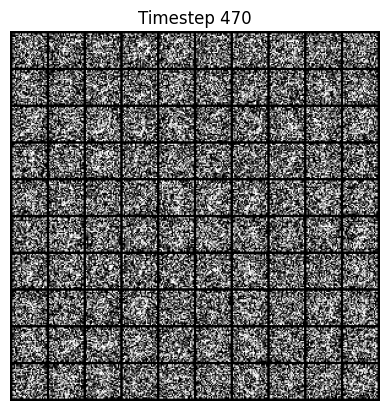

539it [01:55,  5.16it/s]

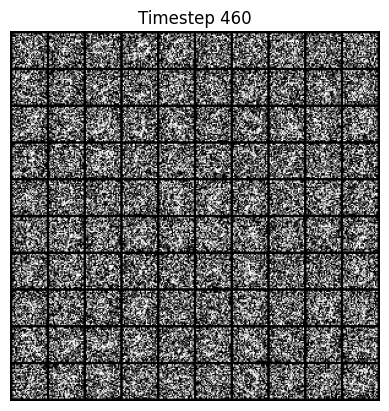

549it [01:57,  5.17it/s]

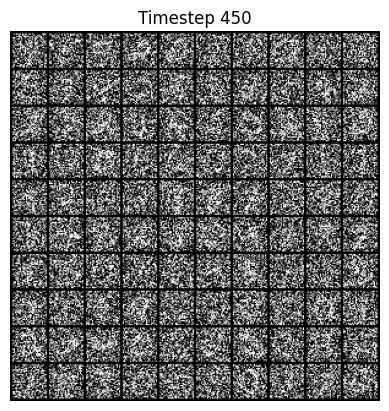

559it [01:59,  5.17it/s]

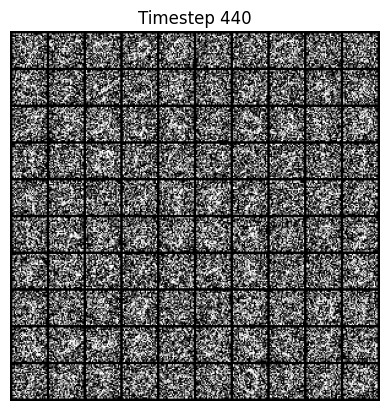

569it [02:02,  5.18it/s]

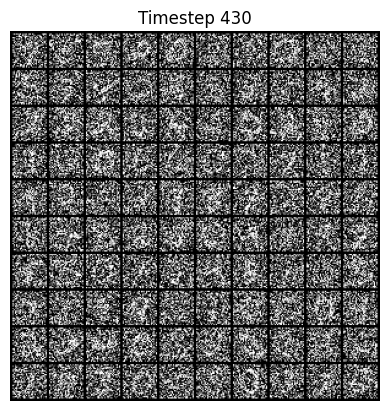

579it [02:04,  5.19it/s]

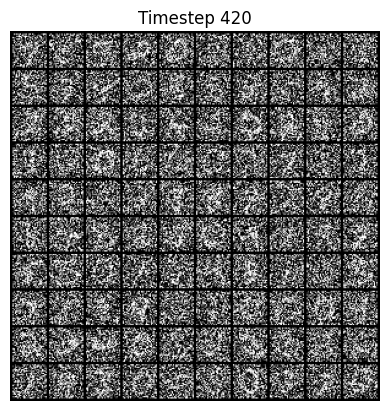

589it [02:06,  5.20it/s]

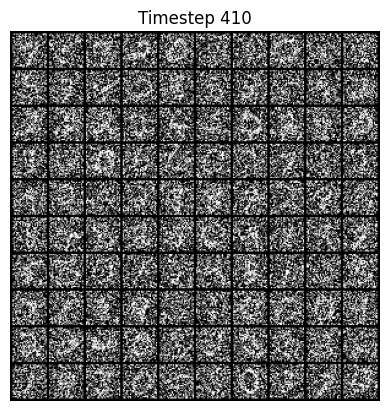

599it [02:08,  5.18it/s]

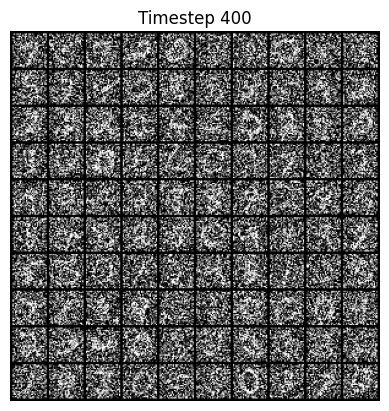

609it [02:10,  5.17it/s]

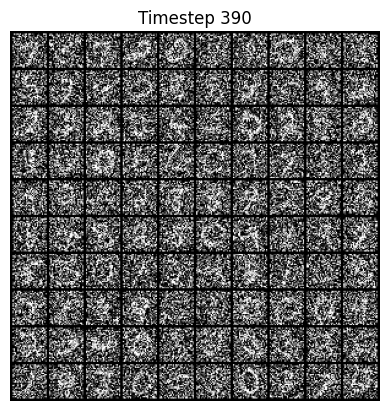

619it [02:12,  5.15it/s]

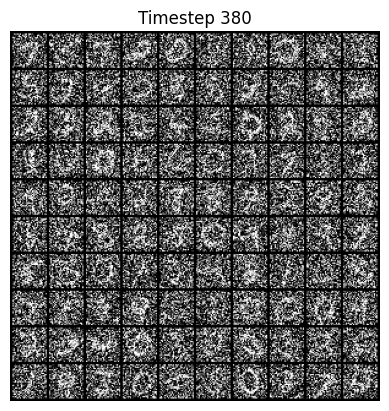

629it [02:15,  5.21it/s]

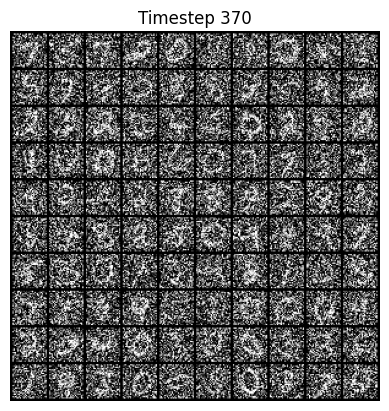

639it [02:17,  5.18it/s]

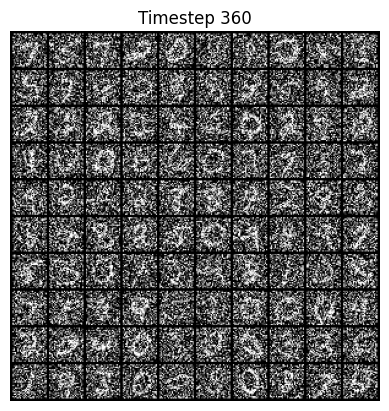

649it [02:19,  5.20it/s]

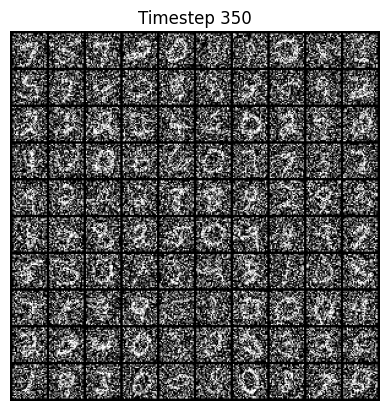

659it [02:21,  5.21it/s]

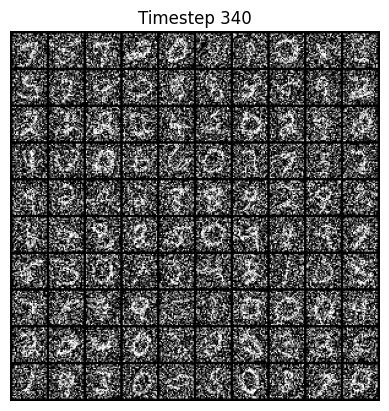

669it [02:23,  5.10it/s]

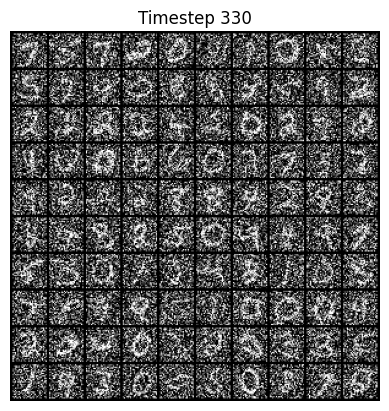

679it [02:26,  5.16it/s]

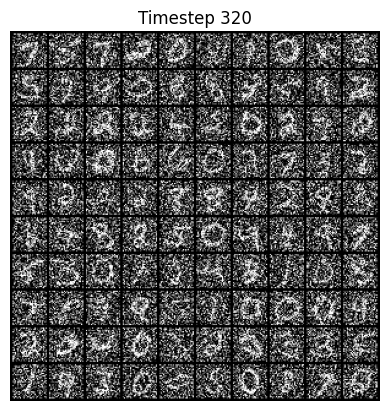

689it [02:28,  5.17it/s]

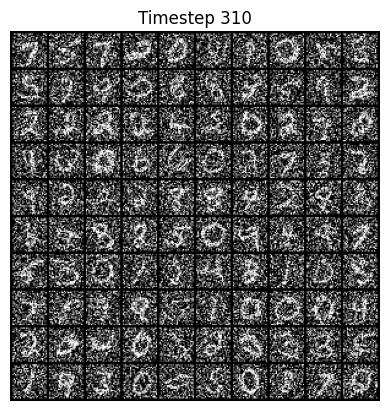

699it [02:30,  5.21it/s]

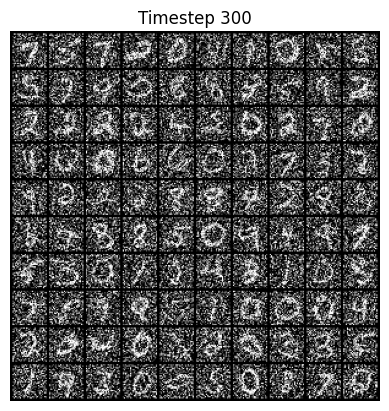

709it [02:32,  5.14it/s]

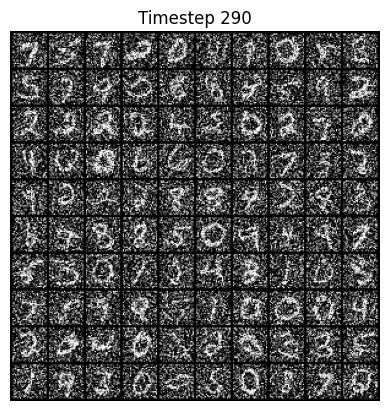

719it [02:34,  5.19it/s]

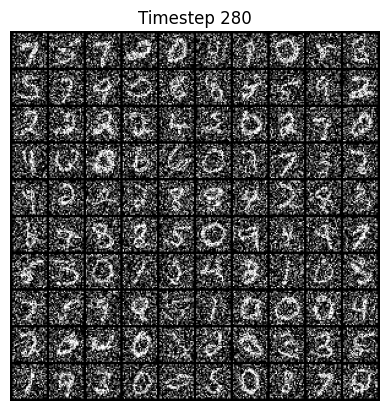

729it [02:36,  5.19it/s]

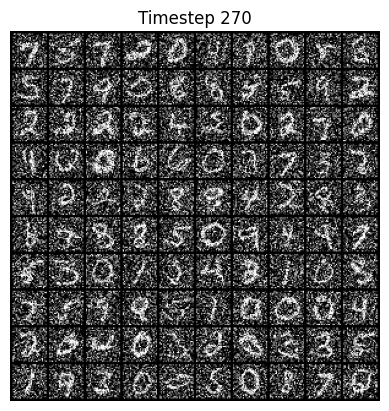

739it [02:39,  5.17it/s]

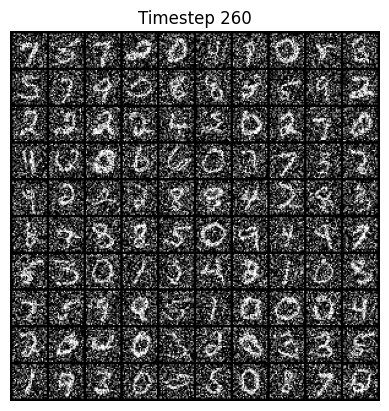

749it [02:41,  5.17it/s]

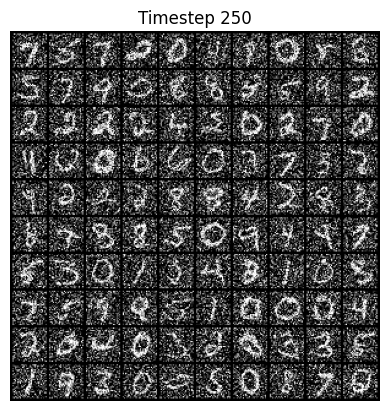

759it [02:43,  5.19it/s]

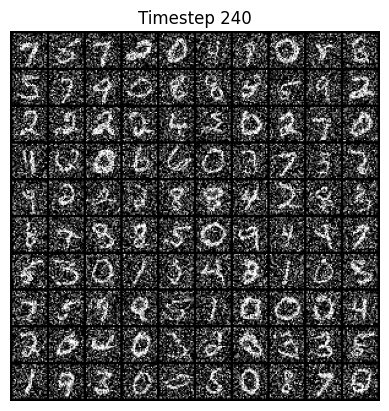

769it [02:45,  5.20it/s]

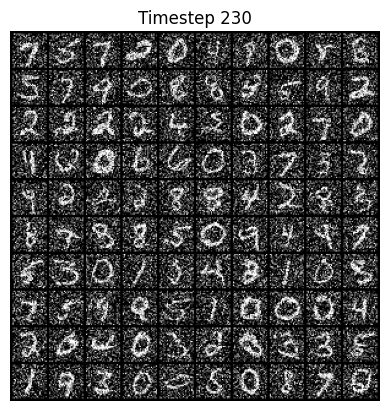

779it [02:47,  5.17it/s]

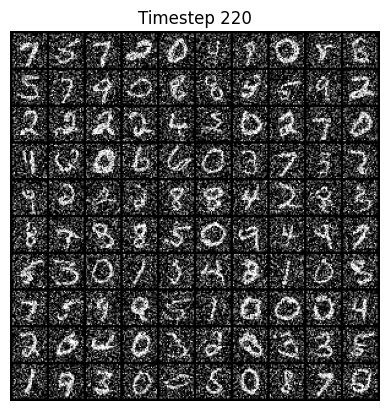

789it [02:49,  5.18it/s]

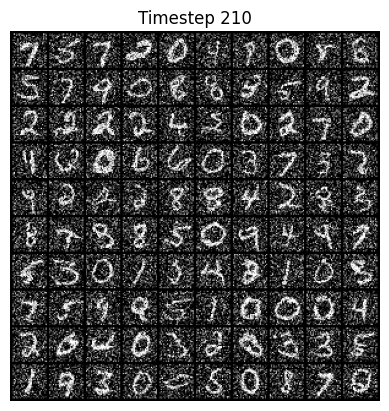

799it [02:52,  5.20it/s]

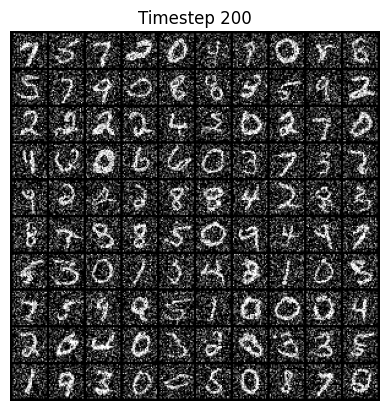

809it [02:54,  5.16it/s]

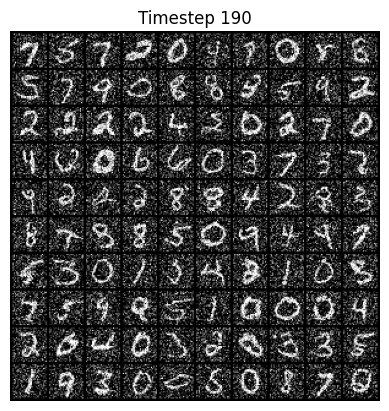

819it [02:56,  5.16it/s]

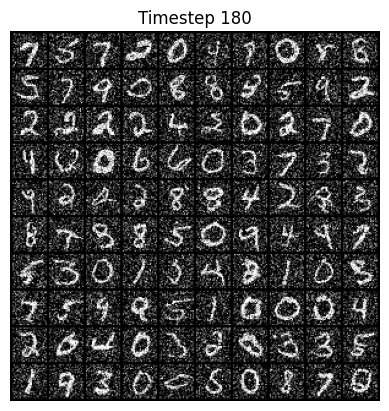

829it [02:58,  5.20it/s]

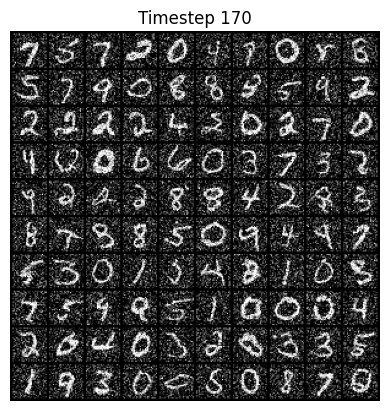

839it [03:00,  5.21it/s]

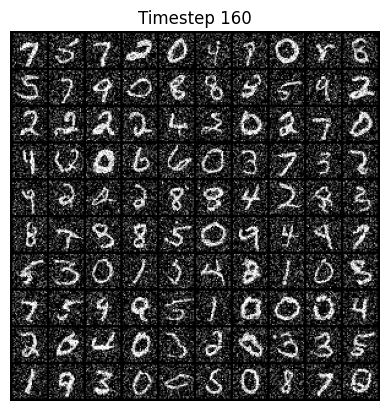

849it [03:02,  5.19it/s]

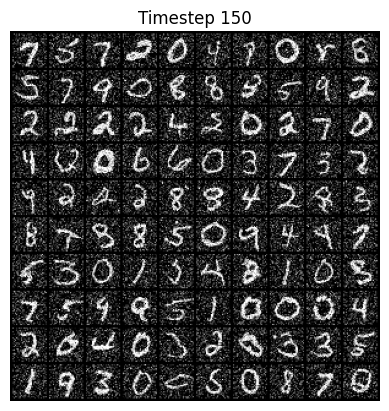

859it [03:05,  5.21it/s]

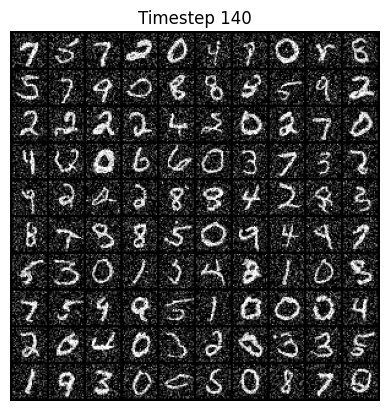

869it [03:07,  5.17it/s]

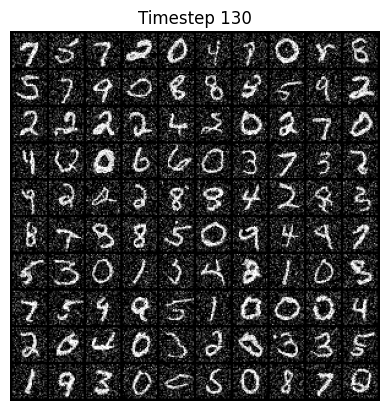

879it [03:09,  5.19it/s]

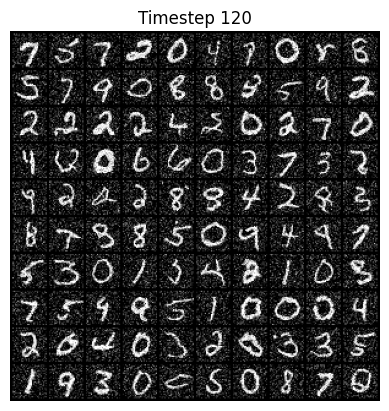

889it [03:11,  5.19it/s]

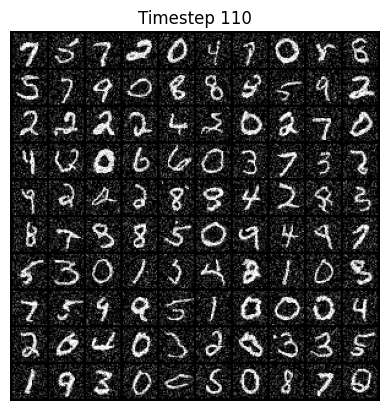

899it [03:13,  5.19it/s]

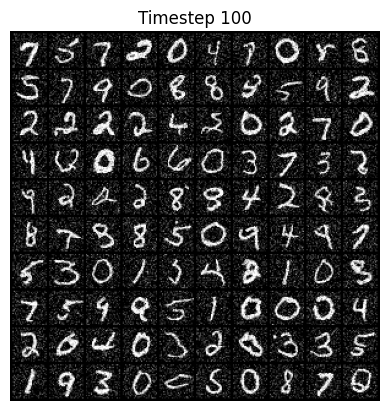

909it [03:15,  5.20it/s]

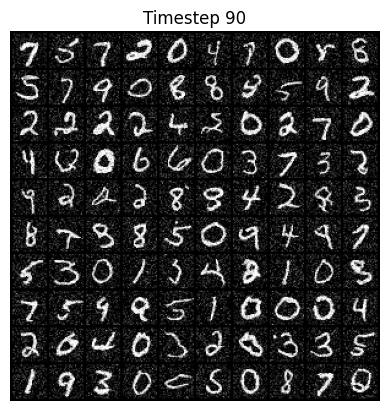

919it [03:18,  5.19it/s]

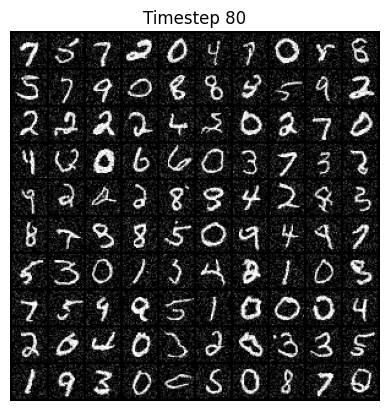

929it [03:20,  5.21it/s]

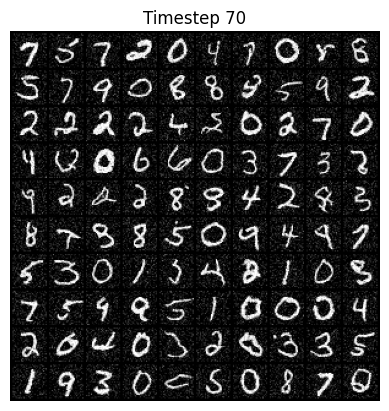

939it [03:22,  5.20it/s]

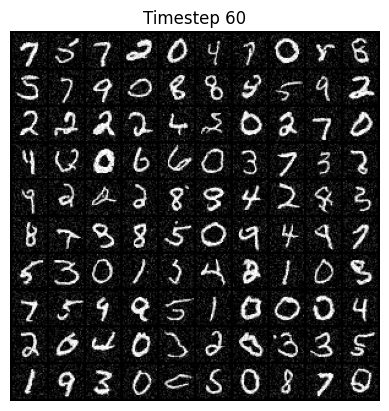

949it [03:24,  5.17it/s]

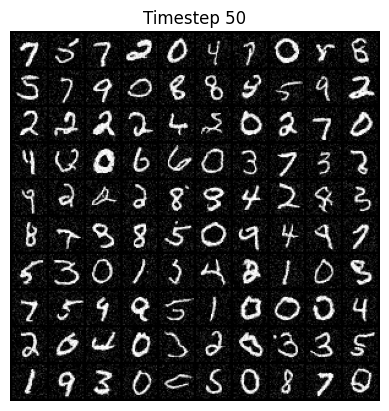

959it [03:26,  5.21it/s]

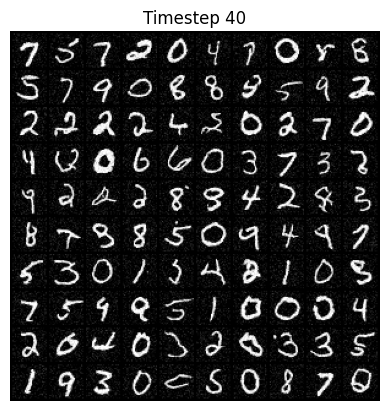

969it [03:28,  5.20it/s]

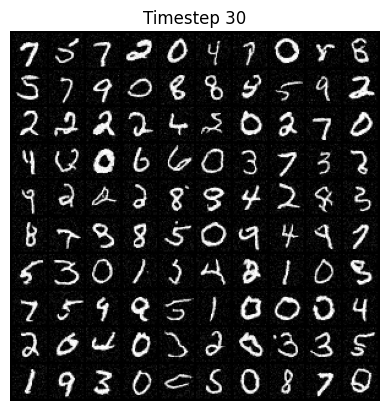

979it [03:30,  5.21it/s]

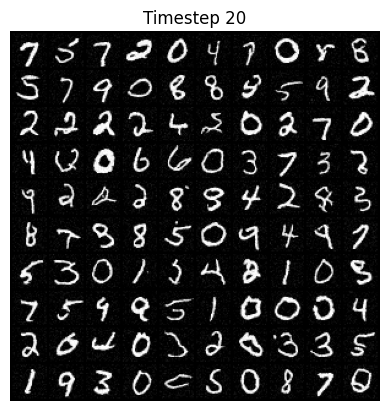

989it [03:32,  5.18it/s]

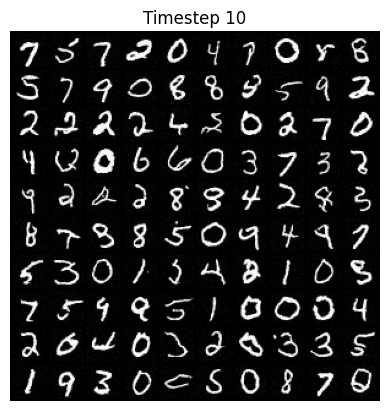

999it [03:35,  5.16it/s]

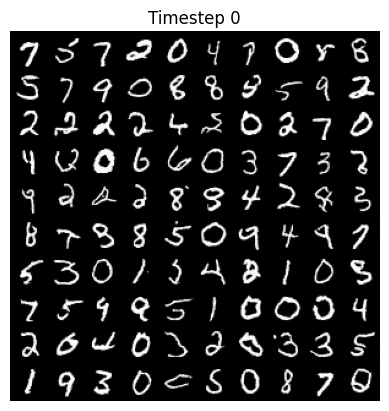

1000it [03:35,  4.64it/s]


In [17]:
# Run inference with your config
infer(config)